In [1]:
import sys
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from imblearn.ensemble import BalancedRandomForestClassifier
import pprint
import pandas as pd
from pycaret.classification import *
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import roc_auc_score, precision_recall_curve, auc, confusion_matrix

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7f265fc46050>
Traceback (most recent call last):
  File "/home/master/.pyenv/versions/miniconda3-latest/envs/ml/lib/python3.10/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/home/master/.pyenv/versions/miniconda3-latest/envs/ml/lib/python3.10/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
  File "/home/master/.pyenv/versions/miniconda3-latest/envs/ml/lib/python3.10/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
  File "/home/master/.pyenv/versions/miniconda3-latest/envs/ml/lib/python3.10/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
AttributeError: 'NoneType' object has no attribute 'spl

In [2]:
%%capture --no-display
%load_ext autoreload
%autoreload 2

project_root = Path.cwd().parent

if str(project_root) not in sys.path:
    sys.path.append(str(project_root))
from weedcrop.autofarm import *

print(f"Successfully imported from: {project_root / 'weedcrop'}")

<div align="center">

# Autofarming
## Surgical Weed Control via Multi-modal Feature Fusion

<br>

**Student:** Ioannis Petrousov  
**Email:** [contact@petrousoft.com](mailto:contact@petrousoft.com)  

<br>

**MSc in Artificial Intelligence**  
**Course:** Machine Learning  
**Date:** February 2026

<br>
<br>

| | |
|:---:|:---:|
| <img src="https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcSSFd6A0n_C6Wb_JrgfkI0GioEeeCFArki1-g&s" width="200"/> | <img src="https://upload.wikimedia.org/wikipedia/en/thumb/a/a4/UNIPI_Emblem.png/250px-UNIPI_Emblem.png" width="200"/> |
| **NCSR Demokritos** | **University of Piraeus** |

<br>

---

</div>

<div align="center">
    <h1>Motivation</h1>
    <img src="https://preview.redd.it/ad5iframit841.jpg?width=640&crop=smart&auto=webp&s=2bab3a9a58d06760acd84202ca95ec3ce2eef50f" width="1000" alt="Interstellar Autonomous Combine"/>
    <p><i>Fiction: GPS-guided autonomous combine in Interstellar (2014).</i></p> 
</div>

Vision: 100% autonomous labor.

Scale: Entire landscapes managed by robots.

The Magic of Hollywood: The movie skips the hardest part—how the machine sees the **difference between a crop and a weed**.

- Interstellar (2014)
- Autonomous farming machines manage vast fields without human intervention
- A high-tech necessity for a dying world.

<div align="center">
    <h1>From fiction to reality</h1>
    <img src="https://www.naio-technologies.com/wp-content/uploads/2021/03/dino-tien-tran-hans-lucas-hd-3-2.jpg" width="800" alt="Autonomous weeding machine"/>
    <figcaption>Dino: Autonomous weeding machine - Naio Technologies.</figcaption>
</div>

<br>

> "By some estimates, 255 different weed species have already developed resistance in 92 crops in 70 countries. Yet, no major new herbicide mode of action has been introduced to the marketplace for almost 20 years."
> — *[Successful Farming (Agriculture.com)](https://www.agriculture.com/technology/robotics/the-future-of-robotic-weeders)*

<br>

- **Industrial Momentum:** Leading companies developing proprietary systems include **John Deere**, **AGCO**, and **Ecorobotix**.
- **Sustainability:** Drastic reduction in herbicide usage by moving away from blanket spraying to precise, individual weed targeting.
- **Labor Efficiency:** Providing a scalable solution to the critical global shortage of agricultural labor.

<div align="center">
    <h1>The challenge</h1>
    <p><i>The ML Challenge: The core of this revolution is Computer Vision—the ability for a machine to distinguish life from life (Crop vs. Weed).</i></p>
</div>


<div align="center">
    <h1>Dataset Overview & Initial Exploration</h1>
</div>

- Annotated Food Crops and Weed Images in their early seedling stages
- Locations: Latvia
- 8 weed and 6 food species
- Seedlings cultivated in controlled greenhouse conditions and open field conditions
- Camera models: Canon EOS 800D, Sony W800, Intel RealSense D435

```text
@article{SUDARS2020105833,
  title = {Dataset of annotated food crops and weed images for robotic computer vision control},
  journal = {Data in Brief},
  volume = {31},
  pages = {105833},
  year = {2020},
  issn = {2352-3409},
  doi = {https://doi.org/10.1016/j.dib.2020.105833},
  url = {https://www.sciencedirect.com/science/article/pii/S2352340920307277},
  author = {Kaspars Sudars and Janis Jasko and Ivars Namatevs and Liva Ozola and Niks Badaukis},
}
```

In [3]:
ds = create_dataset_list(ds_dir)
print_ds_info(ds)

Nof weed samples: 1116
Nof crop samples: 60
Weeds/Crops ratio: 18.6


In [4]:
print(f"Class values: {np.unique(np.array(ds)[:, 1])}")

Class values: ['crop' 'weed']


In [5]:
get_dataset_resolution_stats(ds);

Stats: {'min': (360, 360), 'max': (1280, 1000), 'avg': (1177, 704)}


As you can understand this dataset is very inconsistent.

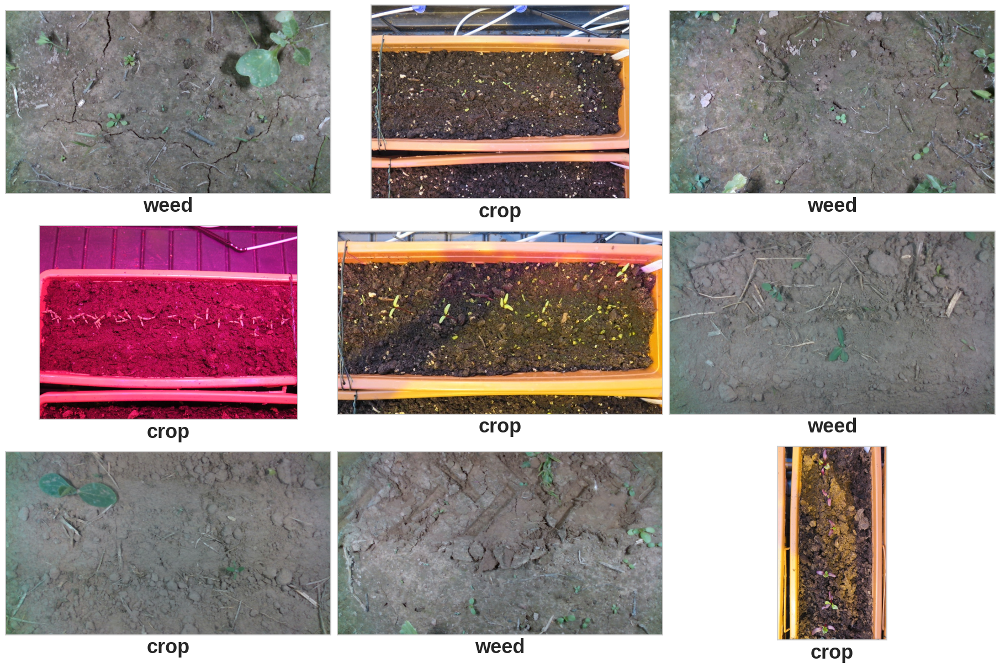

In [6]:
visualize_ds_sample(ds)

<div align="center">
    <h1>Dataset preparation</h1>
</div>

1. Create dataset path
2. Create ds list
3. Load images into memory
4. Resize to equal size - 256x256
5. Extract labels

In [7]:
%%time
X_rez, y_labels = prepare_ds_pipeline()
list(map(len, [X_rez, y_labels]))

CPU times: user 55.4 s, sys: 1min 15s, total: 2min 10s
Wall time: 3min


[1176, 1176]

<div align="center">
    <h1>Feature Engineering</h1>
</div>

<div align="center">
    <h2>1. Histogram of Oriented Graphs - HOG</h2>
</div>

- Used in shape recongnition.
- HOG captures the distribution of intensity gradients - edges and shapes

```python
orientations=9,
pixels_per_cell=(8, 8),
cells_per_block=(2, 2),
```

In [8]:
%%time
X_hog_features = extract_hog_features_from_list(X_rez)

CPU times: user 15.5 s, sys: 20.5 ms, total: 15.5 s
Wall time: 15.5 s


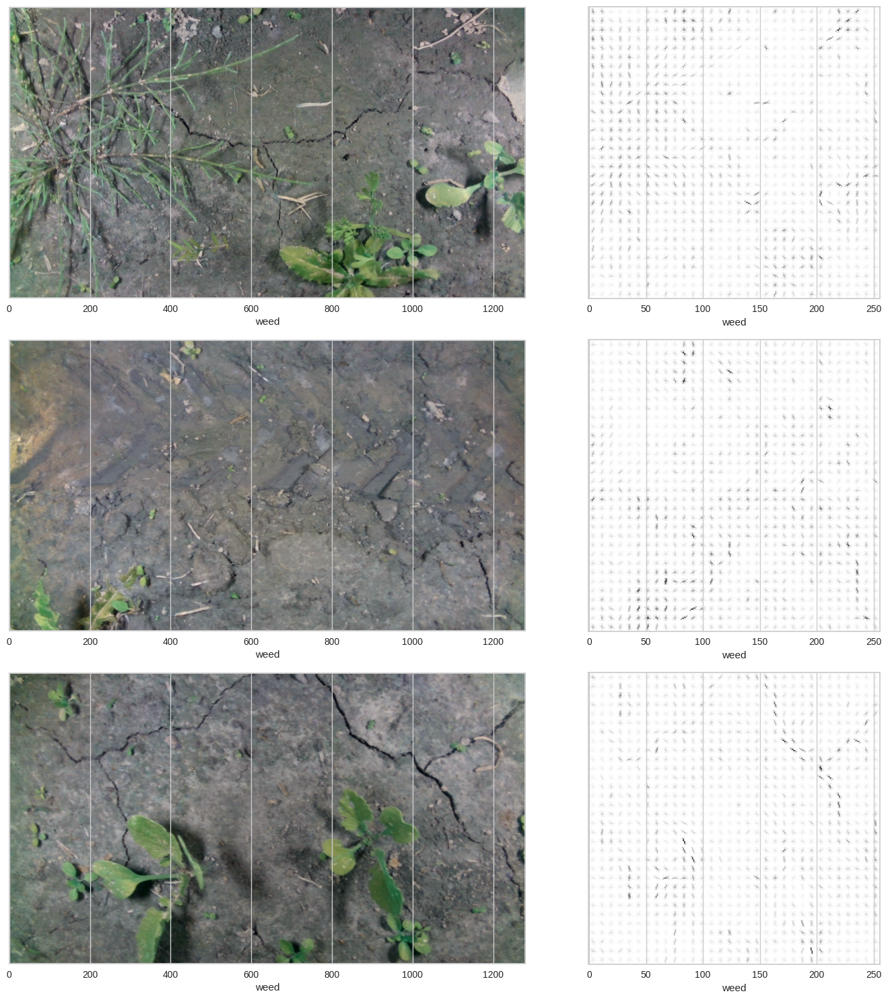

In [9]:
visualize_hog_features(ds)

<div align="center">
    <h3>HOG features per image</h3>
</div>

In [10]:
len(X_hog_features[0])

34596

The amount of HOG feature is too high for statistical models.

Can we reduce?

<div align="center">
    <h3>Reduce the amount of HOG features</h3>
</div>

- We have way too many HOG features for statistical model.
- Let's use Principal Component Analysis - PCA

In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Standardize the data (Mean=0, StdDev=1)
X_hog_scaled = StandardScaler().fit_transform(X_hog_features)

# Sanity check
print(f"Mean: {round(np.mean(X_hog_scaled))}, Std. Dev: {round(np.std(X_hog_scaled))}")

# Nof initial components/features we have
print(f"Initial nof components: {len(X_hog_scaled[0])}")

# Apply PCA
pca_check = PCA(n_components=800)
pca_check.fit(X_hog_scaled)

Mean: 0, Std. Dev: 1
Initial nof components: 34596


PCA(n_components=800)

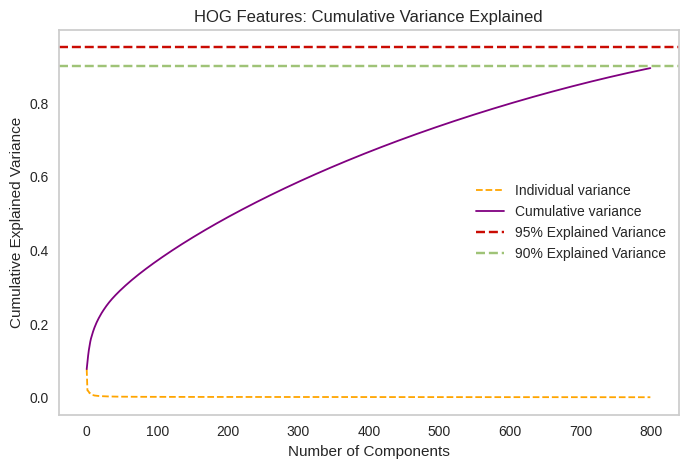

In [12]:
# Extract variance
variance_ratio = pca_check.explained_variance_ratio_
cumulative_variance = np.cumsum(variance_ratio)

# Plot the Scree Plot
plt.figure(figsize=(8, 5))
plt.plot(variance_ratio, linewidth=1.3, linestyle="--", color="orange", label="Individual variance")
plt.plot(cumulative_variance, linewidth=1.3, linestyle="-", color="purple", label="Cumulative variance")
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('HOG Features: Cumulative Variance Explained')
plt.axhline(y=0.95, color='r', linestyle='--', label='95% Explained Variance')
plt.axhline(y=0.90, color='g', linestyle='--', label='90% Explained Variance')
plt.legend()
plt.grid()
plt.show()

In [13]:
pca_apply = PCA(n_components=800)
X_hog_reduced = pca_apply.fit_transform(X_hog_scaled)

<div align="center">
    <h2>2. Local Binary Pattern - LBP</h2>
</div>

- Used for texture description
- Labels pixels by comparing their intensity to their neighbors
- Creates a binary code representing local texture
- Used in face recognition, texture analysis, and object detection

In [14]:
%%time
X_lbp_features = extract_lbp_features_from_list(X_rez)
len(X_lbp_features[0])

CPU times: user 6 s, sys: 0 ns, total: 6 s
Wall time: 6 s


10

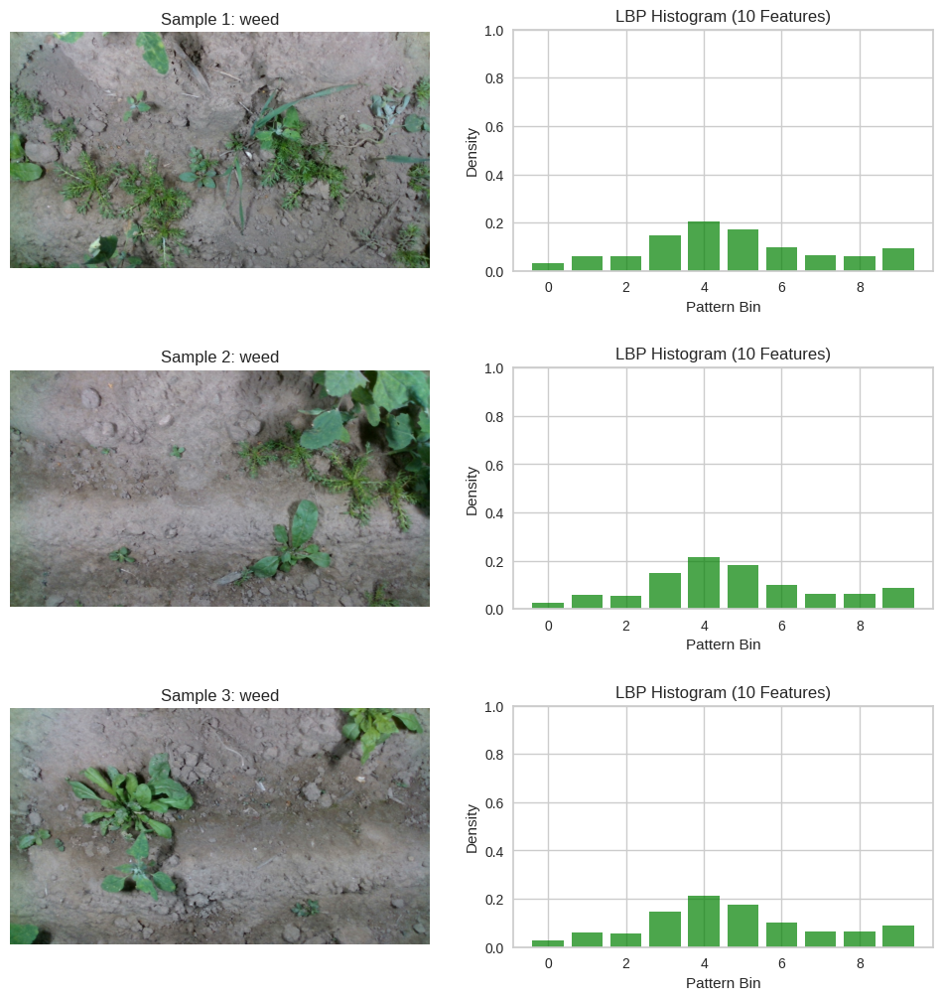

In [15]:
visualize_lbp_features(ds)

<div align="center">
    <h2>3. RGB to HSV</h2>
</div>

- Hue Saturation Value - HSV
- Useful in extracing shapes from the images - segmentation.
- Allows us to analyze the patterns in the images

**Goal**: extract the green parts (plants & weeds) from the brown/grey soil and pots.
**How**: apply filters on these channels.

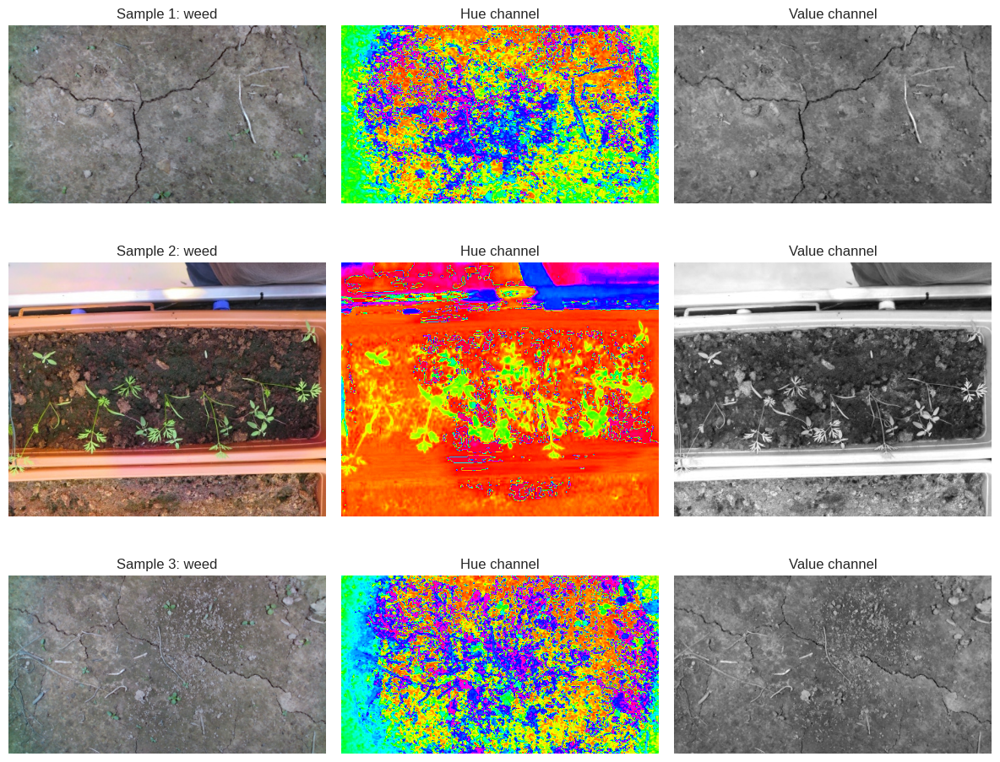

In [16]:
visualize_hsv_channels(ds)

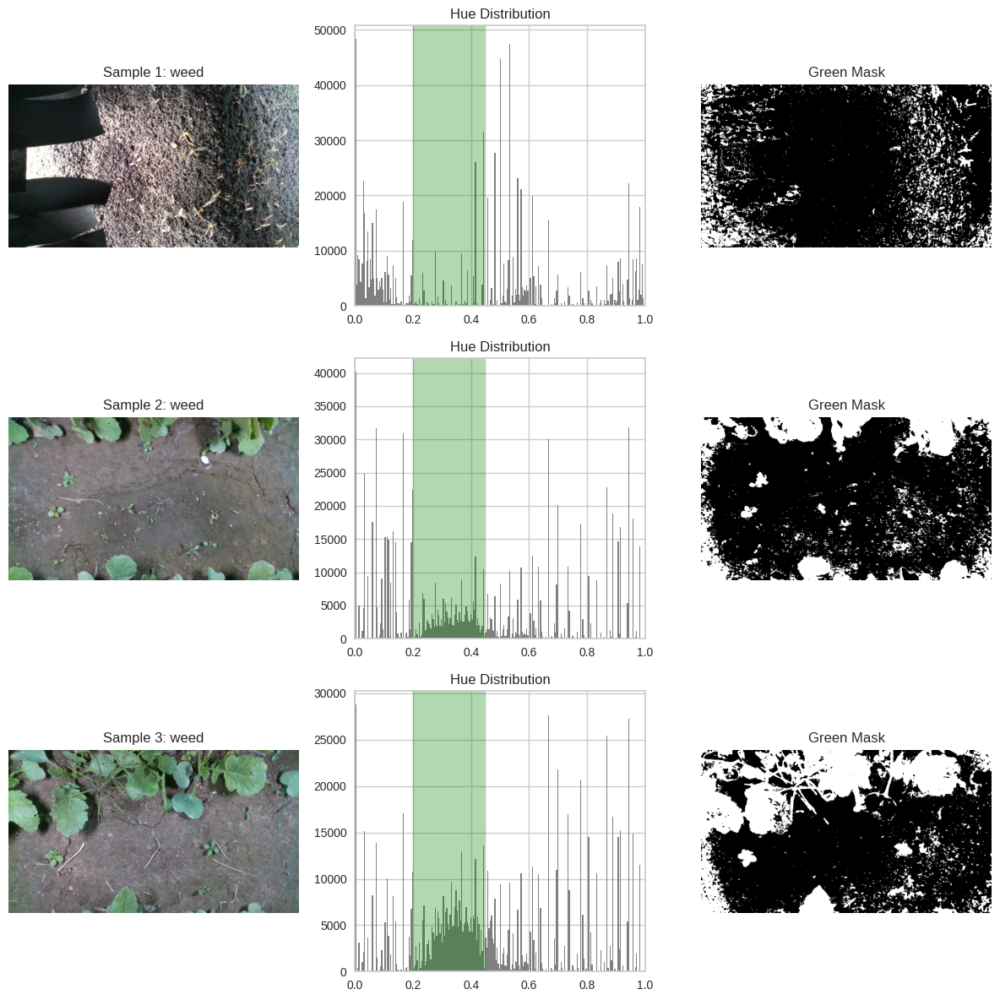

In [17]:
visualize_hue_thresholding(ds, hue_lower_bound=0.2, hue_upper_bound=0.45)

We seem to be capturing a lot of information about the plant shapes.
Can we do better?

Yes! Let's also involve the Saturation channel.

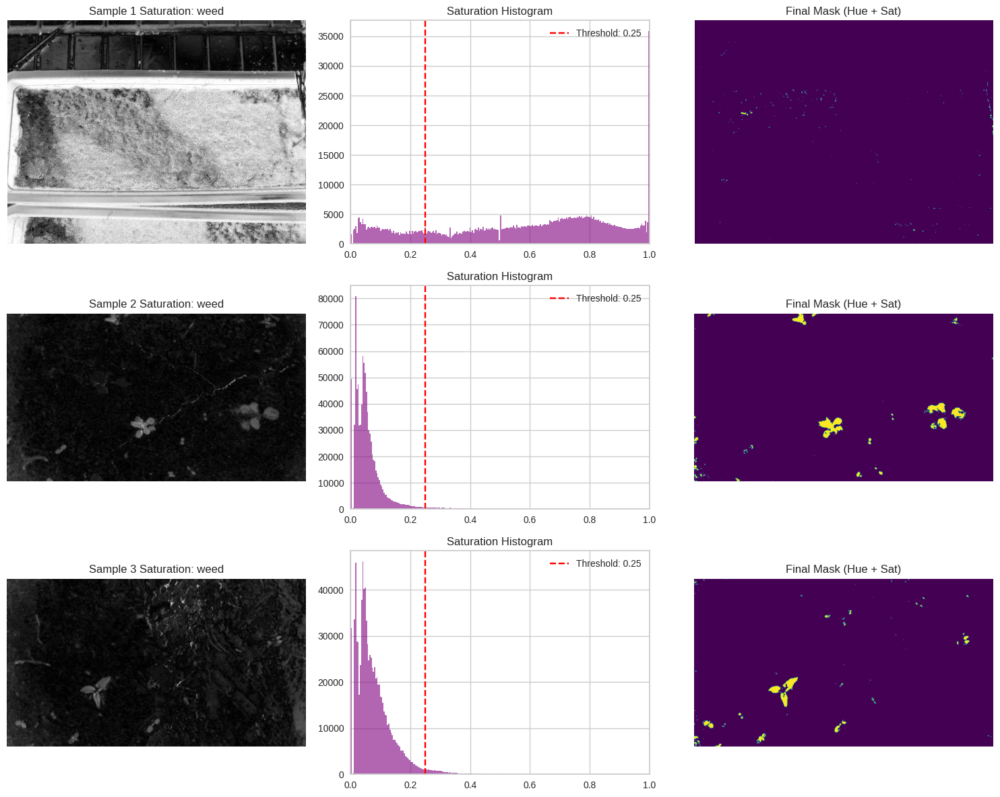

In [18]:
visualize_saturation_thresholding(ds, hue_lower_bound=0.2, hue_upper_bound=0.45, sat_lower=0.25)

In [19]:
%%time
X_hsv_features = extract_hsv_features_from_list(X_rez)

CPU times: user 10.1 s, sys: 0 ns, total: 10.1 s
Wall time: 10.1 s


In [20]:
# Default: 10 bins, 3 channels = 30
X_hsv_features.shape

(1176, 30)

<div align="center">
    <h1>Augmentations</h1>
</div>

- The dataset is highly imbalanced
- We have at least 18 `weed` images for each `crop` image

Augmentations on the `crop` samples in the `training dataset` ONLY!

Steps:

- split the dataset using `train_test_split`
- extract the `crop` images from train
- augment `crop` train images


In [21]:
# Split dataset
X_train, X_test, y_train, y_test = train_test_split(
    X_rez,
    y_labels,
    train_size=0.8,
    stratify=y_labels, # Balances sets
    random_state=42
)

print(f"Lens:{len(X_train), len(X_test)}")

# Train crop indices
train_crop_indices = [ i for i, elm in enumerate(y_train) if elm == "crop" ]
print(f"Train crops: {len(train_crop_indices)}")

# Sanity check only
test_crop_indices = [ i for i, elm in enumerate(y_test) if elm == "crop" ]
print(f"Test crops: {len(test_crop_indices)}")

# Gather train crop images
train_crop_images = [ X_train[i] for i in train_crop_indices ]

Lens:(940, 236)
Train crops: 48
Test crops: 12


<div align="center">
    <h2>Augmentation pipeline</h2>
</div>

Library: https://albumentations.ai/

In [22]:
import albumentations as A
transform = A.Compose([
    A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.1, rotate_limit=20, p=0.3),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.GaussianBlur(blur_limit=(3, 5), p=0.1),
    A.GaussNoise(std_range=(0.04, 0.2), p=0.2),
])
transform.set_random_seed(42)

In [23]:
%%time
# Augment train crop images
train_crop_aug = [ transform(image=img.astype("float32")) for img in train_crop_images ]

CPU times: user 33.7 ms, sys: 0 ns, total: 33.7 ms
Wall time: 35.3 ms


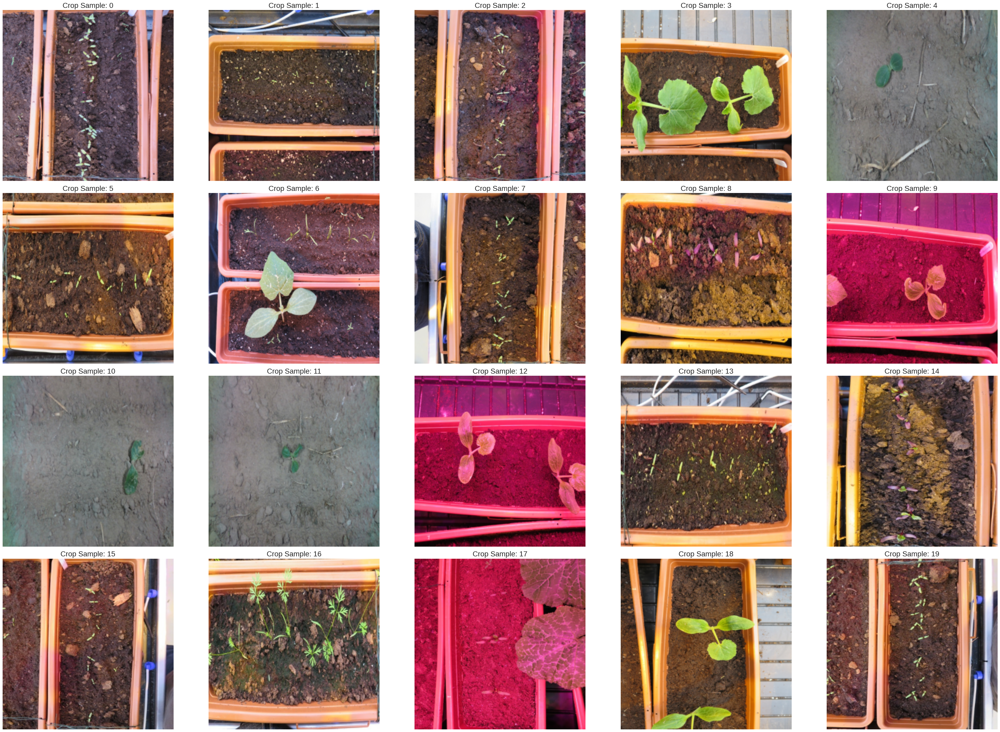

In [24]:
# Initial crop sample
visualize_crop_samples(train_crop_images, rows=4, cols=5)

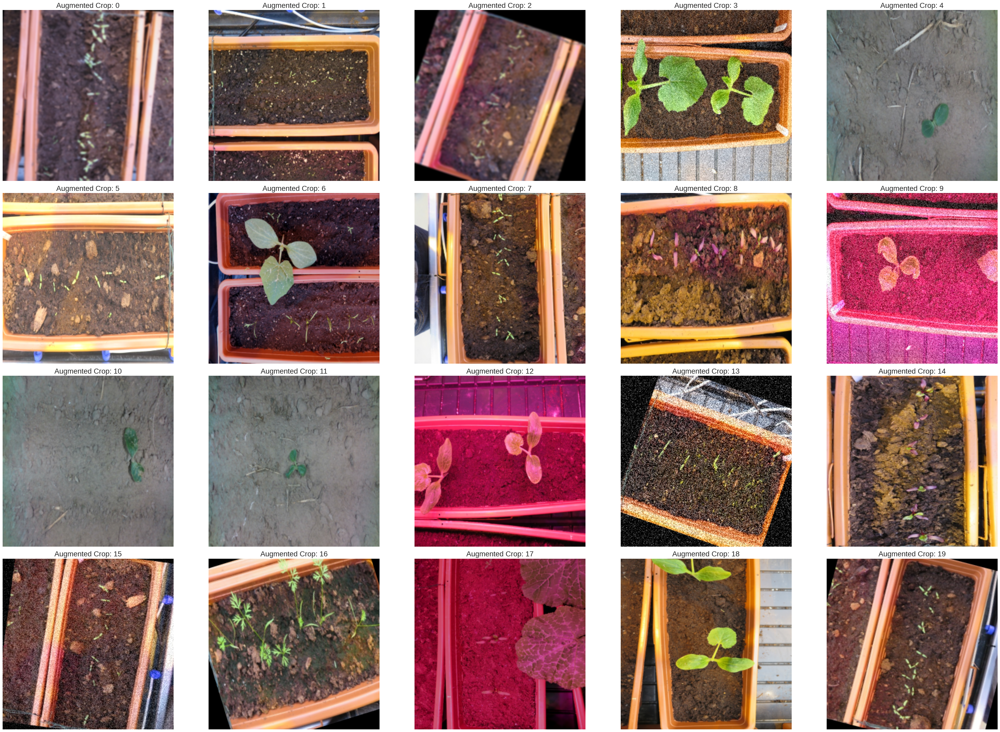

In [25]:
# Augmented crop sample
visualize_augmented_crops(train_crop_aug, n_rows=4, cols=5)

---

<div align="center">
    <h2>Build the "golden" dataset</h2>
</div>

- Before doing any modeling, we need a **"golden" dataset** for the experiements.  
- `autofarm` module comes with QoL features built-in: 

In [26]:
# Delete demos - free memory
# Prep X_train, y_train, X_test, y_test
# del X_hog_features, X_hog_reduced, X_hog_scaled, X_hsv_features, X_lbp_features, X_rez, X_test, X_train, X_train_combined

In [27]:
%%time
X_train_gold, y_train_gold, X_test_gold, y_test_gold = build_experimental_ds()

CPU times: user 2min 27s, sys: 1min 53s, total: 4min 20s
Wall time: 5min 2s


<div align="center">
    <h1>Modeling</h1>
</div>

- I ran more than 18 experiments evaluating different models and dataset combinations
- I will share only the most interesting ones

| Experiment | Dataset | Comments |
| --- | --- | --- |
| **BalancedRandomForestClassifier** |  **LBP + HOG (full) features** | **`sampling ALL`** |
| **BalancedRandomForestClassifier** |  **LBP + HOG (full) features** | **sampling MAJORITY** |
| BalancedRandomForestClassifier |  LBP + HOG (PCA) features | |
| **BalancedRandomForestClassifier** |  **LBP + HOG (PCA) + HSV features** | **`class_weight={"crop": 1, "weed": 0.75}`** |
| PyCaret | LBP + HOG (PCA) + HSV features | Train all available models (14) |
| **PyCaret** | **LBP + HOG (PCA) + HSV features** | **Naive Bayes** |
| **PyCaret** | **LBP + HOG (PCA) + HSV features** | **Naive Bayes `Precision` tuned**|
| **PyCaret** | **LBP + HOG (PCA) + HSV features** | **Naive Bayes Redacted dataset** |
| PyCaret | LBP + HOG (PCA) + HSV + Augmentations | Naive Bayes |
| GaussianNB optimization `var_smoothing` | LBP + HOG (PCA) + HSV + Augmentations | `var_smoothing=0.1` |
| GaussianNB optimization `sample weights` | LBP + HOG (PCA) + HSV + Augmentations | `weed_weight=2.81` |
| GaussianNB optimization `hard sample weights` | LBP + HOG (PCA) + HSV + Augmentations | `hard_weed_weight=3.5`  |
| GaussianNB optimization `probability threshold` | LBP + HOG (PCA) + HSV + Augmentations | `threshold=0.5900` | 
| GaussianNB **grid optmization** | LBP + HOG (PCA) + HSV + Augmentations |  | 

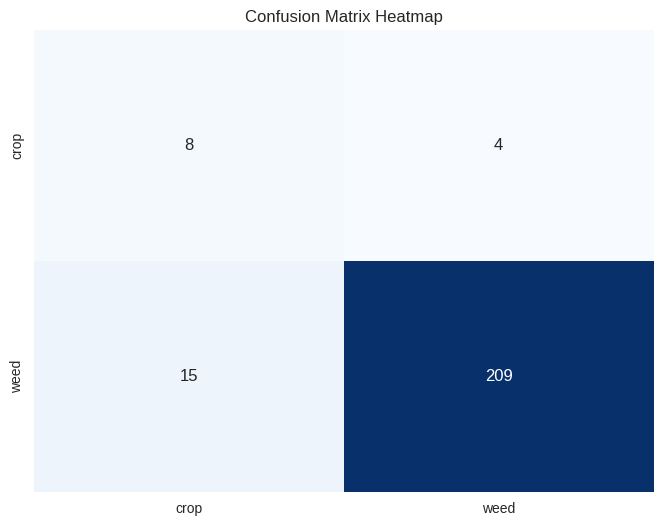

{'Accuracy sklearn': 0.9194915254237288,
 'Accuracy custom': 0.9194915254237288,
 'Conf Matrix': array([[  8,   4],
       [ 15, 209]]),
 'Recall crop': 0.6666666666666666,
 'Recall weed': 0.9330357142857143,
 'Precision crop: (TP/(TP+FP))': 0.34782608695652173,
 'Precision weed': 0.9812206572769953,
 'F1 crop': 0.4571428571428571,
 'F1 weed': 0.9565217391304348,
 'F1 macro': 0.7068322981366459}


In [28]:
# BalancedRandomForestClassifier (LBP + HOG (PCA) + HSV features) - sampling_strategy = all

model = BalancedRandomForestClassifier(n_estimators=100, sampling_strategy="all", replacement=True, random_state=42)
model.fit(X_train_gold, y_train_gold)
y_pred = model.predict(X_test_gold)
bfc_ss_all_metrics = evaluate(y_test_gold, y_pred, print_cnfm=True)
pprint.pp(bfc_ss_all_metrics)

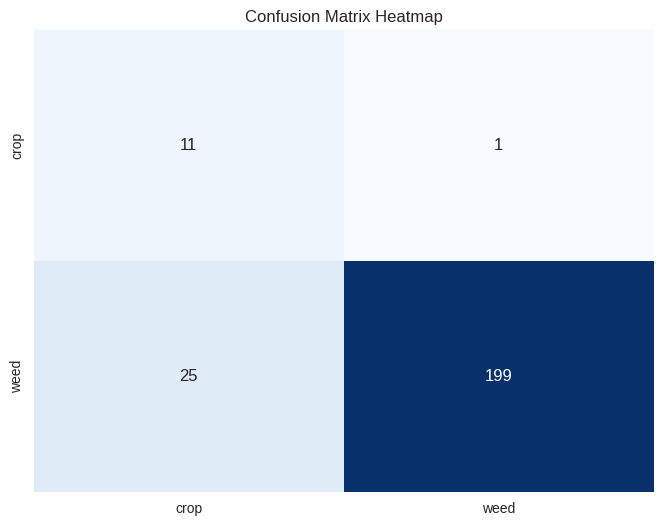

{'Accuracy sklearn': 0.9194915254237288,
 'Accuracy custom': 0.9194915254237288,
 'Conf Matrix': array([[  8,   4],
       [ 15, 209]]),
 'Recall crop': 0.6666666666666666,
 'Recall weed': 0.9330357142857143,
 'Precision crop: (TP/(TP+FP))': 0.34782608695652173,
 'Precision weed': 0.9812206572769953,
 'F1 crop': 0.4571428571428571,
 'F1 weed': 0.9565217391304348,
 'F1 macro': 0.7068322981366459}


In [29]:
# BalancedRandomForestClassifier (LBP + HOG (PCA) + HSV features) - sampling_strategy = MAJORITY

model = BalancedRandomForestClassifier(n_estimators=100, sampling_strategy="majority", replacement=True, random_state=42)
model.fit(X_train_gold, y_train_gold)
y_pred = model.predict(X_test_gold)
bfc_ss_maj_metrics = evaluate(y_test_gold, y_pred, print_cnfm=True)
pprint.pp(bfc_ss_all_metrics)

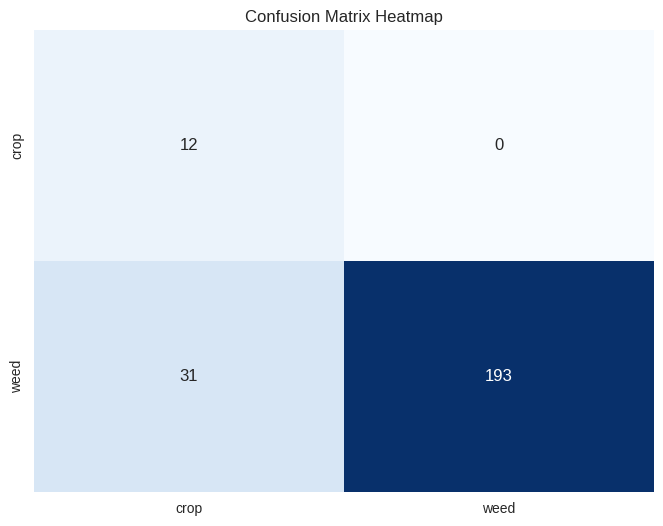

{'Accuracy sklearn': 0.9194915254237288,
 'Accuracy custom': 0.9194915254237288,
 'Conf Matrix': array([[  8,   4],
       [ 15, 209]]),
 'Recall crop': 0.6666666666666666,
 'Recall weed': 0.9330357142857143,
 'Precision crop: (TP/(TP+FP))': 0.34782608695652173,
 'Precision weed': 0.9812206572769953,
 'F1 crop': 0.4571428571428571,
 'F1 weed': 0.9565217391304348,
 'F1 macro': 0.7068322981366459}


In [30]:
# BalancedRandomForestClassifier - class_weight={"crop": 1, "weed": 0.75}, majority sampling
class_weight={"crop": 1, "weed": 0.75}
model = BalancedRandomForestClassifier(n_estimators=100, sampling_strategy="majority", replacement=True, class_weight=class_weight, random_state=42)
model.fit(X_train_gold, y_train_gold)
y_pred = model.predict(X_test_gold)
bfc_ss_maj_weights_metrics = evaluate(y_test_gold, y_pred, print_cnfm=True)
pprint.pp(bfc_ss_all_metrics)

In [31]:
# PyCaret (LBP + HOG (PCA) + HSV features) - algorithm olympics

# 1. Prep DataFrames
df_train_gold = pd.DataFrame(X_train_gold)
df_train_gold["type"] = y_train_gold

df_test_gold = pd.DataFrame(X_test_gold)
df_test_gold["type"] = y_test_gold

# 2. Initialize Setup 
clf_setup = setup(
    data = df_train_gold, 
    test_data = df_test_gold,
    target = "type",
    session_id = 42,
    fix_imbalance = False,
    preprocess = False,
    index = False,
    html = False
)
best = clf_setup.compare_models()

                   Description        Value
0                   Session id           42
1                       Target         type
2                  Target type       Binary
3          Original data shape  (1320, 841)
4       Transformed data shape  (1320, 841)
5  Transformed train set shape  (1084, 841)
6   Transformed test set shape   (236, 841)
7             Numeric features          840


                                    Model  Accuracy     AUC  Recall   Prec.  \
lightgbm  Light Gradient Boosting Machine    0.9613  0.9812  0.9613  0.9627   
gbc          Gradient Boosting Classifier    0.9548  0.9767  0.9548  0.9557   
lr                    Logistic Regression    0.9548  0.9693  0.9548  0.9545   
rf               Random Forest Classifier    0.9511  0.9811  0.9511  0.9513   
knn                K Neighbors Classifier    0.9511  0.9363  0.9511  0.9514   
ada                  Ada Boost Classifier    0.9493  0.9584  0.9493  0.9491   
et                 Extra Trees Classifier    0.9484  0.9720  0.9484  0.9514   
svm                   SVM - Linear Kernel    0.9456  0.9180  0.9456  0.9451   
dt               Decision Tree Classifier    0.9262  0.8835  0.9262  0.9285   
nb                            Naive Bayes    0.8672  0.8546  0.8672  0.8826   
qda       Quadratic Discriminant Analysis    0.8229  0.7650  0.8229  0.6771   
dummy                    Dummy Classifier    0.8229 

      Accuracy     AUC  Recall   Prec.      F1   Kappa     MCC
Fold                                                          
0       0.9450  0.9807  0.9450  0.9445  0.9423  0.7915  0.7992
1       0.9633  0.9895  0.9633  0.9649  0.9615  0.8610  0.8694
2       0.9633  0.9812  0.9633  0.9649  0.9617  0.8672  0.8750
3       0.9541  0.9907  0.9541  0.9566  0.9515  0.8305  0.8427
4       0.9259  0.9763  0.9259  0.9237  0.9243  0.7335  0.7351
5       0.9537  0.9840  0.9537  0.9532  0.9521  0.8298  0.8341
6       0.9352  0.9624  0.9352  0.9332  0.9329  0.7617  0.7657
7       0.9444  0.9805  0.9444  0.9431  0.9432  0.8001  0.8019
8       0.9537  0.9805  0.9537  0.9562  0.9508  0.8219  0.8353
9       0.9722  0.9855  0.9722  0.9731  0.9713  0.8979  0.9026
Mean    0.9511  0.9811  0.9511  0.9513  0.9492  0.8195  0.8261
Std     0.0132  0.0075  0.0132  0.0145  0.0133  0.0472  0.0488


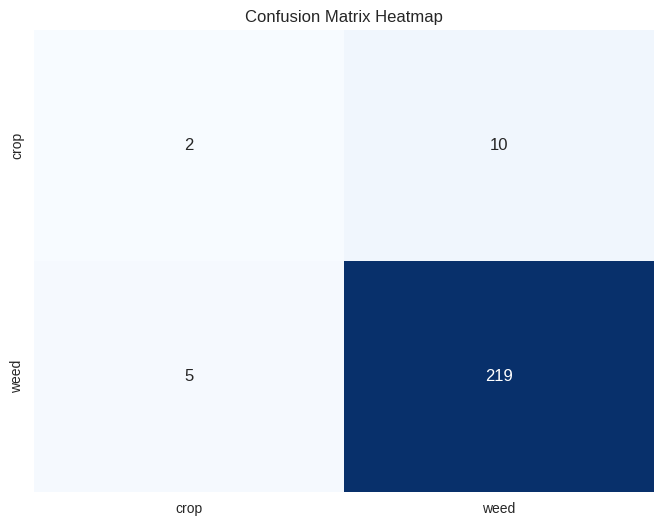

{'Accuracy sklearn': 0.9364406779661016,
 'Accuracy custom': 0.9364406779661016,
 'Conf Matrix': array([[  2,  10],
       [  5, 219]]),
 'Recall crop': 0.16666666666666666,
 'Recall weed': 0.9776785714285714,
 'Precision crop: (TP/(TP+FP))': 0.2857142857142857,
 'Precision weed': 0.9563318777292577,
 'F1 crop': 0.2105263157894737,
 'F1 weed': 0.9668874172185431,
 'F1 macro': 0.5887068665040084}


In [46]:
# Pycaret Naive Bayes - test any algorithm - conclusion is the same
pycaret_model = create_model("rf")
y_preds = pycaret_model.predict(X_test_gold)
pycaret_model_metrics = evaluate(y_test_gold, y_preds, print_cnfm=True)
pprint.pp(pycaret_model_metrics)

In [47]:
tuned_pycaret_model = tune_model(pycaret_model, optimize="Recall")
# Get the new predictions
y_preds_tuned = tuned_pycaret_model.predict(X_test_gold)

Processing:   0%|                                                                                                                       | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


      Accuracy     AUC  Recall   Prec.      F1   Kappa     MCC
Fold                                                          
0       0.9541  0.9696  0.9541  0.9565  0.9513  0.8222  0.8355
1       0.9633  0.9860  0.9633  0.9649  0.9615  0.8610  0.8694
2       0.9633  0.9798  0.9633  0.9649  0.9617  0.8672  0.8750
3       0.9541  0.9792  0.9541  0.9566  0.9515  0.8305  0.8427
4       0.9352  0.9639  0.9352  0.9332  0.9329  0.7617  0.7657
5       0.9630  0.9864  0.9630  0.9646  0.9612  0.8607  0.8692
6       0.9352  0.9509  0.9352  0.9332  0.9329  0.7617  0.7657
7       0.9444  0.9846  0.9444  0.9440  0.9418  0.7911  0.7989
8       0.9537  0.9734  0.9537  0.9562  0.9508  0.8219  0.8353
9       0.9630  0.9823  0.9630  0.9646  0.9612  0.8607  0.8692
Mean    0.9529  0.9756  0.9529  0.9539  0.9507  0.8239  0.8326
Std     0.0106  0.0108  0.0106  0.0120  0.0108  0.0385  0.0401


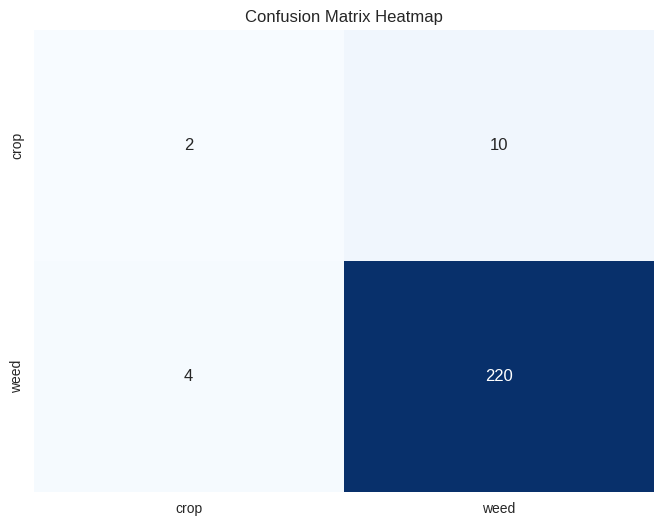

{'Accuracy sklearn': 0.940677966101695,
 'Accuracy custom': 0.940677966101695,
 'Conf Matrix': array([[  2,  10],
        [  4, 220]]),
 'Recall crop': 0.16666666666666666,
 'Recall weed': 0.9821428571428571,
 'Precision crop: (TP/(TP+FP))': 0.3333333333333333,
 'Precision weed': 0.9565217391304348,
 'F1 crop': 0.2222222222222222,
 'F1 weed': 0.9691629955947136,
 'F1 macro': 0.595692608908468}

In [48]:
evaluate(y_test_gold, y_preds_tuned, print_cnfm=True)

<div align="center">
    <h2>PyCaret conclusion</h2>
</div>

- Experimenting with `PyCaret` is time consuming.
- Narrow down the algorithm you believe will perform optimally.
- Create own metric functions to "tune" on.

Runnig algorithm olympics with `Pycaret` showed that perhaps `Naive Bayes` is a more robust algorithm for this dataset.

- Predicts category using probabilities.
- Assumes all features are independent.
- Features are equally important.

In [33]:
# PyCaret LBP + HOG (PCA) + HSV features Naive Bayes Redacted dataset
# 0.379310


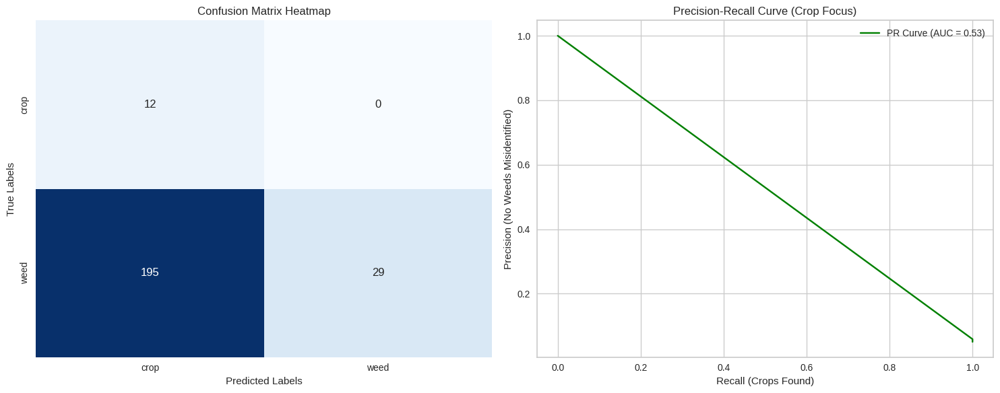

{'Accuracy sklearn': 0.17372881355932204,
 'Accuracy custom': 0.17372881355932204,
 'Conf Matrix': array([[ 12,   0],
       [195,  29]]),
 'Recall crop': 1.0,
 'Recall weed': 0.12946428571428573,
 'Precision crop: (TP/(TP+FP))': 0.057971014492753624,
 'Precision weed': 1.0,
 'F1 crop': 0.1095890410958904,
 'F1 weed': 0.22924901185770752,
 'F1 macro': 0.16941902647679896,
 'AUC score': 0.5736607142857143}


In [34]:
# Naive Bayes vanilla

nb_clf = GaussianNB()
nb_clf.fit(X_train_gold, y_train_gold)
nb_preds_vanilla = nb_clf.predict(X_test_gold)
nb_probs_vanilla = nb_clf.predict_proba(X_test_gold)[:, 0]
nb_clf_vanilla_metrics = evaluate(y_test_gold, nb_preds_vanilla, y_probs=nb_probs_vanilla, print_cnfm=True)
pprint.pp(nb_clf_vanilla_metrics)

Optimum var_smoothing: 0.13
Optmized Precision 0.23
Optmized Recall 0.92


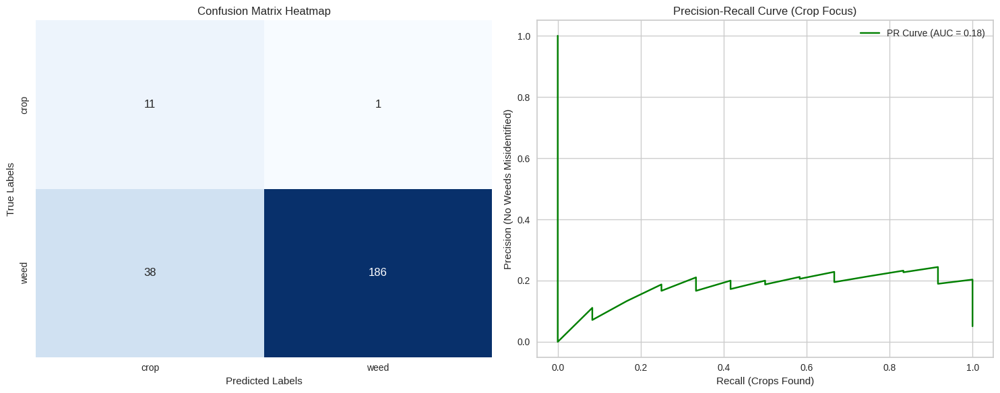

{'Accuracy sklearn': 0.8347457627118644,
 'Accuracy custom': 0.8347457627118644,
 'Conf Matrix': array([[ 11,   1],
       [ 38, 186]]),
 'Recall crop': 0.9166666666666666,
 'Recall weed': 0.8303571428571429,
 'Precision crop: (TP/(TP+FP))': 0.22448979591836735,
 'Precision weed': 0.9946524064171123,
 'F1 crop': 0.36065573770491804,
 'F1 weed': 0.905109489051095,
 'F1 macro': 0.6328826133780066,
 'AUC score': 0.8909970238095238}


In [49]:
# GaussianNB optimization var_smoothing LBP + HOG (PCA) + HSV + Augmentations
# Custom optimizer - var_smoothing

smoothing_grid = np.logspace(-5, 2, 300)
optim_var_smoothing = 1e-9
prec_crop = 0
rec_crop = 0

for vs in smoothing_grid:
    nb_clf = GaussianNB(var_smoothing=vs)
    nb_clf.fit(X_train_gold, y_train_gold)
    nb_preds = nb_clf.predict(X_test_gold)
    nb_probs = nb_clf.predict_proba(X_test_gold)[:, 0]
    r = evaluate(y_test_gold, nb_preds, y_probs=nb_probs, print_cnfm=False)
    
    if (r["Precision crop: (TP/(TP+FP))"] > prec_crop):# and (r["Recall crop"] > rec_crop):
        optim_var_smoothing = round(vs, 6)
        prec_crop = r["Precision crop: (TP/(TP+FP))"]
        rec_crop = r["Recall crop"]
        
    
print(f"Optimum var_smoothing: {optim_var_smoothing:.2f}\nOptmized Precision {prec_crop:.2f}\nOptmized Recall {rec_crop:.2f}")
    
# Evaluate Optimum NB
nb_clf = GaussianNB(var_smoothing=round(optim_var_smoothing, 2))
nb_clf.fit(X_train_gold, y_train_gold)
nb_preds = nb_clf.predict(X_test_gold)
nb_probs = nb_clf.predict_proba(X_test_gold)[:, 0]
nb_clf_smooth_opt_metrics = evaluate(y_test_gold, nb_preds, y_probs=nb_probs, print_cnfm=True)
pprint.pp(nb_clf_smooth_opt_metrics)

Optimum ALL weed weight: 1.08
Optmized Precision 0.23
Optmized Recall 0.92


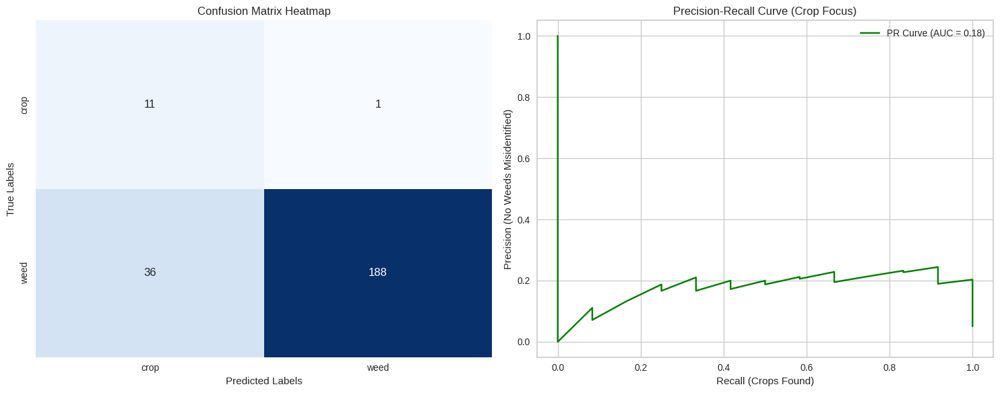

{'Accuracy sklearn': 0.8432203389830508,
 'Accuracy custom': 0.8432203389830508,
 'Conf Matrix': array([[ 11,   1],
       [ 36, 188]]),
 'Recall crop': 0.9166666666666666,
 'Recall weed': 0.8392857142857143,
 'Precision crop: (TP/(TP+FP))': 0.23404255319148937,
 'Precision weed': 0.9947089947089947,
 'F1 crop': 0.3728813559322034,
 'F1 weed': 0.9104116222760291,
 'F1 macro': 0.6416464891041163,
 'AUC score': 0.8909970238095238}


In [50]:
# GaussianNB optimization sample weights  LBP + HOG (PCA) + HSV + Augmentations 
# Custom optimizer - all TRAIN weed weights

prec_crop = 0
rec_crop = 0
optim_all_weed_weight = 0.

for w in np.linspace(0.8, 10, 100):
    weights = [w if label == "weed" else 1. for label in y_train_gold]
    weights = np.array(weights)
    
    # Re-fit
#     nb_clf = GaussianNB(var_smoothing=optim_var_smoothing)
    nb_clf.fit(X_train_gold, y_train_gold, sample_weight=weights)
    nb_preds = nb_clf.predict(X_test_gold)
    nb_probs = nb_clf.predict_proba(X_test_gold)[:, 1]

    r = evaluate(y_test_gold, nb_preds, y_probs=nb_probs, print_cnfm=False)

    if (r["Precision crop: (TP/(TP+FP))"] > prec_crop):# and (r["Recall crop"] > rec_crop):
        optim_all_weed_weight = w
        prec_crop = r["Precision crop: (TP/(TP+FP))"]
        rec_crop = r["Recall crop"]
        
    
print(f"Optimum ALL weed weight: {optim_all_weed_weight:.2f}\nOptmized Precision {prec_crop:.2f}\nOptmized Recall {rec_crop:.2f}")

# Evaluate Optimum NB
nb_clf = GaussianNB(var_smoothing=round(optim_var_smoothing, 2))
weights = [optim_all_weed_weight if label == "weed" else 1. for label in y_train_gold]
nb_clf.fit(X_train_gold, y_train_gold, sample_weight=weights)
nb_preds = nb_clf.predict(X_test_gold)
nb_probs = nb_clf.predict_proba(X_test_gold)[:, 0]
nb_clf_smooth_opt_weights_opt_metrics = evaluate(y_test_gold, nb_preds, y_probs=nb_probs, print_cnfm=True)
pprint.pp(nb_clf_smooth_opt_weights_opt_metrics)

Somewhere here, I got stuck.
- Should I keep optimizing with `PyCaret`?
- Should I keep experimenting with `BalancedForestClassifiers`?
- Should I try removing some "weed" samples?
- Exploration space is so large - but my time is limited.
- What will I deliver?

Great suggestion by **T. Giannakopoulos**

```text
Algorithmic way to find optimum threshold for Naive Bayes classifier:
- Plot Precision-Recall curve
- Find the "elbow point"
- That's the best classification probability threshold.
```

References:
1. https://medium.com/@juanc.olamendy/choosing-the-right-metrics-recall-precision-pr-curve-and-roc-curve-explained-682259961cbe
2. https://medium.com/@douglaspsteen/precision-recall-curves-d32e5b290248

In [51]:
# GaussianNB optimization probability threshold  LBP + HOG (PCA) + HSV + Augmentations
### Probability threshold optimization
precisions, recalls, thresholds = precision_recall_curve(y_test_gold, nb_probs, pos_label="crop")

# 2. Find the "elbow" where we keep 11/12 crops (Recall >= 0.91)
# we want the highest possible precision at that specific recall level.
target_recall = 0.91
indices = np.where(recalls >= target_recall)[0]

# Ttake the last index from the match - best threshold
best_index = indices[-1] 
pinned_threshold = thresholds[best_index]

print(f"Pinned Threshold from Graph: {pinned_threshold:.4f}")
print(f"Resulting Precision: {precisions[best_index]:.4f}")
print(f"Resulting Recall: {recalls[best_index]:.4f}")

Pinned Threshold from Graph: 0.5083
Resulting Precision: 0.2444
Resulting Recall: 0.9167


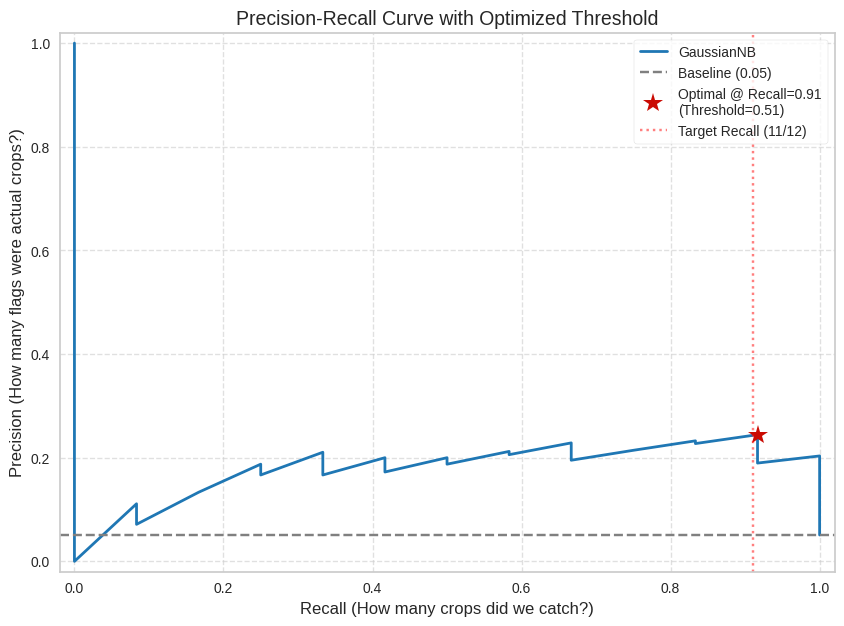

In [38]:
import matplotlib.pyplot as plt
import numpy as np

# 1. Calculate the baseline (random chance)
baseline = y_test_gold.count("crop") / len(y_test_gold)

plt.figure(figsize=(10, 7))

# 2. Plot the main PR curve
plt.plot(recalls, precisions, label="GaussianNB", color="tab:blue", linewidth=2)

# 3. Add the "Baseline" (no-skill) line
plt.axhline(y=baseline, color="gray", linestyle="--", label=f"Baseline ({baseline:.2f})")

# 4. Highlight your "Ideal" Threshold Point (the elbow)
plt.plot(recalls[best_index], precisions[best_index], "r*", ms=15, 
         label=f"Optimal @ Recall=0.91\n(Threshold={pinned_threshold:.2f})")

# 5. Add a vertical line to show where your 0.91 target is
plt.axvline(x=target_recall, color="red", linestyle=":", alpha=0.5, label="Target Recall (11/12)")

plt.title("Precision-Recall Curve with Optimized Threshold", fontsize=14)
plt.xlabel("Recall (How many crops did we catch?)", fontsize=12)
plt.ylabel("Precision (How many flags were actual crops?)", fontsize=12)
plt.xlim([-0.02, 1.02])
plt.ylim([-0.02, 1.02])
plt.legend(loc="upper right", frameon=True)
plt.grid(True, linestyle="--", alpha=0.6)

plt.show()

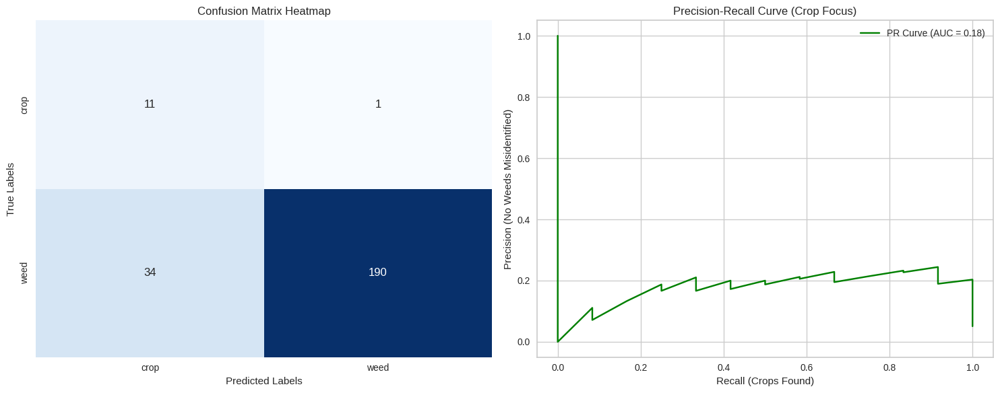

{'Accuracy sklearn': 0.8516949152542372,
 'Accuracy custom': 0.8516949152542372,
 'Conf Matrix': array([[ 11,   1],
       [ 34, 190]]),
 'Recall crop': 0.9166666666666666,
 'Recall weed': 0.8482142857142857,
 'Precision crop: (TP/(TP+FP))': 0.24444444444444444,
 'Precision weed': 0.9947643979057592,
 'F1 crop': 0.3859649122807018,
 'F1 weed': 0.9156626506024096,
 'F1 macro': 0.6508137814415557,
 'AUC score': 0.8909970238095238}


In [39]:
# Use the above threshold and extract metrics
pinned_t = pinned_threshold 

# Create the final probability prediction
final_preds = ["crop" if p >= pinned_t else "weed" for p in nb_probs]

# Final Evaluation
nb_clf_smooth_opt_weights_opt_thresh_opt_metrics = evaluate(y_test_gold, final_preds, y_probs=nb_probs, print_cnfm=True)
pprint.pp(nb_clf_smooth_opt_weights_opt_thresh_opt_metrics)

<div align="center">
    <h1>Experimental results</h1>
</div>

<div align="center">
    <img src="https://static0.cbrimages.com/wordpress/wp-content/uploads/2019/09/Great-Scott-Doc-Browns-Best-Back-to-the-Future-Inventions-Explained.jpg?q=50&fit=crop&w=1232&h=693&dpr=1.5" width="800" alt="Dr. Brown"/>
    <figcaption style="font-size: 8px; color: gray;">Dr. Emmet Brown - Back to the Future.</figcaption>
</div>

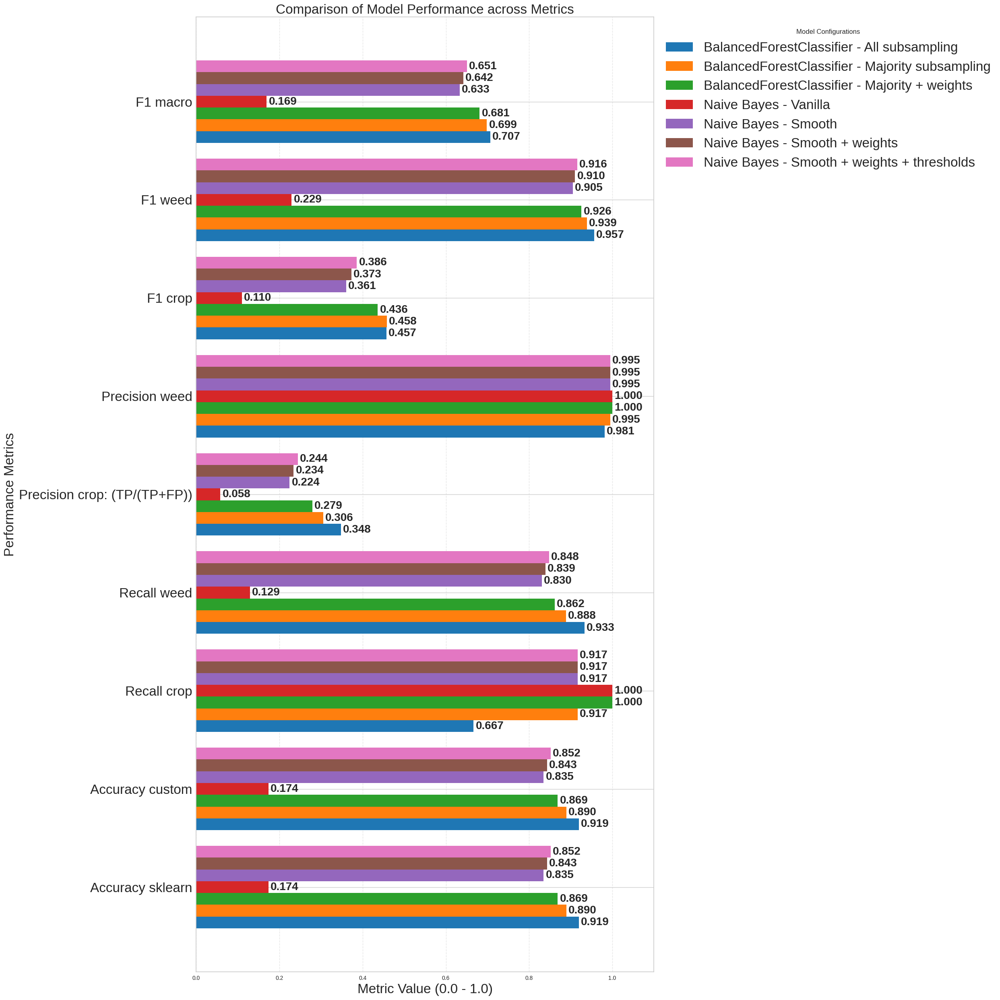

In [76]:
# 1. Your dictionary of models
all_models = {
    "BalancedForestClassifier - All subsampling": bfc_ss_all_metrics,
    "BalancedForestClassifier - Majority subsampling": bfc_ss_maj_metrics,
    "BalancedForestClassifier - Majority + weights": bfc_ss_maj_weights_metrics,
    "Naive Bayes - Vanilla": nb_clf_vanilla_metrics,
    "Naive Bayes - Smooth": nb_clf_smooth_opt_metrics,
    "Naive Bayes - Smooth + weights": nb_clf_smooth_opt_weights_opt_metrics,
    "Naive Bayes - Smooth + weights + thresholds": nb_clf_smooth_opt_weights_opt_thresh_opt_metrics
}

# Deifne custom colors
custom_colors = [
    "#1f77b4", # Blue
    "#ff7f0e", # Orange
    "#2ca02c", # Green
    "#d62728", # Red
    "#9467bd", # Purple
    "#8c564b", # Brown
    "#e377c2"  # Pink
]

# 2. Extract numeric metrics 
# We look at the first model to get the list of metric names
first_model_data = list(all_models.values())[0]
metrics = [k for k in first_model_data.keys() if isinstance(first_model_data[k], (int, float))]

# 3. Setup plot parameters
y_positions = np.arange(len(metrics)) # Metric label locations
total_models = len(all_models)
bar_height = 0.12
plt.figure(figsize=(25, 25))

# 4. Plot each model
for i, (name, data) in enumerate(all_models.items()):
    # Calculate offset so bars are centered around the metric label
    offset = (i - (total_models - 1) / 2) * bar_height
    
    # Extract the values for each metric for this model
    values = [data.get(m, 0) for m in metrics]
    
    bars = plt.barh(y_positions + offset, values, bar_height, label=name, color=custom_colors[i])
    
    # Add numbers to bars
    for bar in bars:
        width = bar.get_width()
        if width > 0: # Only label if there is a value
            plt.text(width + 0.005, bar.get_y() + bar.get_height() / 2, 
                     f"{width:.3f}", va="center", fontsize=20, fontweight="bold")

# 5. Formatting
plt.title("Comparison of Model Performance across Metrics", fontsize=24)
plt.yticks(y_positions, metrics, fontsize=24)
plt.xlabel("Metric Value (0.0 - 1.0)", fontsize=24)
plt.ylabel("Performance Metrics", fontsize=24)

# Place legend outside the plot
plt.legend(title="Model Configurations", loc="upper left", bbox_to_anchor=(1, 1), fontsize=24)

plt.xlim(0, 1.1)
plt.grid(axis="x", linestyle="--", alpha=0.5)
plt.tight_layout()

plt.show()

<div align="center">
    <h1>Conclusion & Future work</h1>
</div>

- We've presented a highly imbalanced dataset
- Explored several direction at mitigating imbalance
    - Feature extraction
    - Augmenetation
    - Subsampling
- Explored a plethora of algorithms - in batches using `PyCaret`

**Deliverables**

- `autofarm`: a python module for "weed"-"crop" classification
    - Values prioretizes saving crops

**Future work**

- Run a parallel grid optimizer exploring combinations of: {`weights`, `var_smoothing`, augmentations}.
- Create a custom metric to optimize for `PyCaret` models.
- Experiment with transformation and feature extraction parameters.


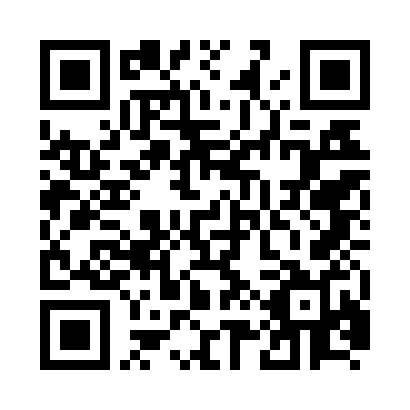

In [85]:
import qrcode
from IPython.display import display, HTML
from io import BytesIO
import base64

# 1. Create the QR code
repo_url = "https://github.com/gpetrousov/ml_assignment_demokritos"
img = qrcode.make(repo_url)

# 2. Convert to base64 for embedding
buffered = BytesIO()
img.save(buffered, format="PNG")
img_str = base64.b64encode(buffered.getvalue()).decode("utf-8")

# 3. Create a single centered layout for the entire slide
display(HTML(f"""
<div style="text-align: center; width: 100%;">
    <h1>Thanks</h1>
    
    <div style="display: flex; justify-content: center; align-items: center; padding: 20px 0;">
        <img src="data:image/png;base64,{img_str}" alt="GitHub Repository QR Code" style="width: 300px; height: 300px;" />
    </div>
    
    <p style="font-size: 18px; color: #555; font-family: sans-serif; text-align: center;">
        <a href="{repo_url}" target="_blank" style="text-decoration: none; color: #1f77b4;">
            {repo_url}
        </a>
    </p>
</div>
"""))

## 1. Problem definition

**Problem definition**
Classifying crops vs. weeds to enable autonomous herbicide application, focusing on high crop recall to ensure yield safety.

## 2. Dataset overview

**Dataset Overview**
Brief description of the data source and the class imbalance (Few crops vs. many weeds).

## 3. Feature Engineering

**The Fusion Logic**
- HOG (shape)
- LBP (texture)
- HSV (color).

**Dimensionality Reduction**
Show the PCA step. Mention that you reduced HOG features to 800 components to prevent the "Curse of Dimensionality" in Naive Bayes.

**Visualizing Features**
Plot a histogram of one feature (e.g., Hue from HSV) comparing Crops and Weeds to show the professor there is a "correlation" as requested in Step 3 of the assignment.

## 4. Model / Fit (The Optimization)

**Baseline Model**
Run a quick vanilla GaussianNB to show it fails (high False Positives).

**Hyperparameter Grid Search**

- Insert your Grid Search code here!!!
- Display the Heatmap (Smoothing vs. Weed Weight).

Text:
The grid search identifies the optimal balance between statistical feature value smoothing and cost-sensitive weighting.

## 5. Evaluate / Communicate (The "Full" Analysis)

- The Surgical Result: Train the final model with best_params.
- The PR-Curve & Pinned Threshold:
    - Plot the Precision-Recall curve.
    - Explain the extraction of the Pinned Threshold
- Final Confusion Matrix: evaluate(print_cnfm=True)
- Business-Level Metrics: * Translate the matrix into real-world terms: "Our model saves 91.6% of crops while rejecting 85% of weeds."

## 6. Conclusions & Future Work

By fusing HOG, LBP, and HSV features with a cost-sensitive GaussianNB, we achieved an AUC of 0.90.

We enriched the minority samples with transformed images and increased the ratio to X

**Future Work**
- Naive Bayes is a strong baseline, future iterations could explore the BalancedRandomForestClassifier
- PyCaret provides a collection of algorithms to experiment with on the optimized dataset

## References


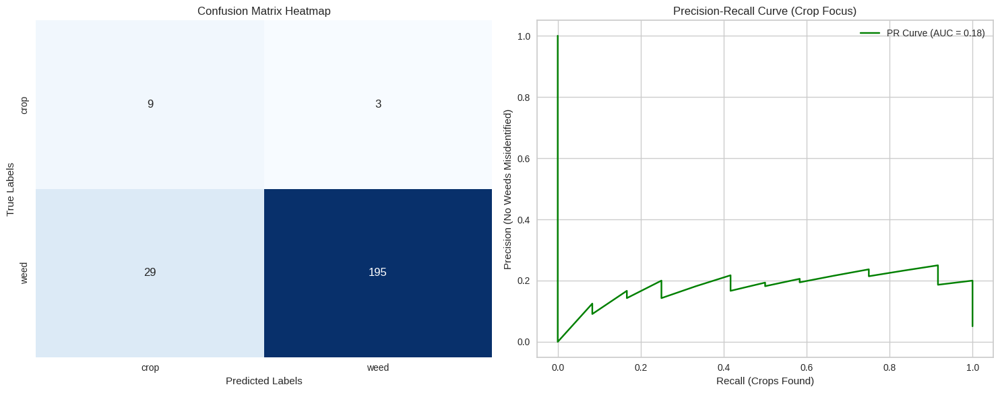

{'Accuracy sklearn': 0.864406779661017,
 'Accuracy custom': 0.864406779661017,
 'Conf Matrix': array([[  9,   3],
        [ 29, 195]]),
 'Recall crop': 0.75,
 'Recall weed': 0.8705357142857143,
 'Precision crop: (TP/(TP+FP))': 0.23684210526315788,
 'Precision weed': 0.9848484848484849,
 'F1 crop': 0.36,
 'F1 weed': 0.9241706161137441,
 'F1 macro': 0.642085308056872,
 'AUC score': 0.8924851190476191}

In [99]:
# Find indices in the TRAINING set that the model gets wrong
train_preds = nb_clf.predict(X_train_gold)
y_train_arr = np.array(y_train_gold)

# Identify weeds the model thinks are crops
hard_weed_indices = np.where((y_train_arr == "weed") & (train_preds == "crop"))[0]

del train_preds, y_train_arr

# Update weights of Hard Weeds
new_weights = np.array([optim_all_weed_weight if label == "weed" else 1. for label in y_train_gold])
new_weights[hard_weed_indices] = 2 # Hard weeds weight

# Re-fit
nb_clf.fit(X_train_gold, y_train_gold, sample_weight=new_weights)
nb_preds = nb_clf.predict(X_test_gold)
nb_probs = nb_clf.predict_proba(X_test_gold)[:, 0]
evaluate(y_test_gold, nb_preds, y_probs=nb_probs, print_cnfm=True)

In [103]:
# Experiment GAUSIAN NB classifier
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Define the grid
smoothing_grid = np.logspace(-9, 1, 10) # 1e-9 to 10
weight_grid = np.linspace(1.0, 5.0, 10) # 1.0 to 5.0

# Storage for results
auc_results = np.zeros((len(smoothing_grid), len(weight_grid)))

best_auc = 0
best_params = {"smooth": 0, "weight": 0}

print("Running Grid Search...")

for i, s in enumerate(smoothing_grid):
    for j, w in enumerate(weight_grid):
        # Prepare weights
        iter_weights = np.ones(len(y_train_gold))
        iter_weights[hard_weed_indices] = w
        
        # Train and get metrics using your experiment function
        # Using print_cnfm=False to stay fast
        m, _, _= experiment_gaussian_nb(X_train_gold, y_train_gold, X_test_gold, y_test_gold, 
                                       var_smoothing=s, 
                                       sample_weight=iter_weights)
        
        auc_results[i, j] = m["AUC score"]
        
        if m["AUC score"] > best_auc:
            best_auc = m["AUC score"]
            best_params = {"smooth": s, "weight": w}
            best_metrics = m

print(f"Optimal found: Smoothing={best_params['smooth']:.2e}, Weight={best_params['weight']:.2f}")
pprint.pp(best_metrics)

Running Grid Search...
Optimal found: Smoothing=5.99e-02, Weight=1.44
{'Accuracy sklearn': 0.059322033898305086,
 'Accuracy custom': 0.059322033898305086,
 'Conf Matrix': array([[ 12,   0],
       [222,   2]]),
 'Recall crop': 1.0,
 'Recall weed': 0.008928571428571428,
 'Precision crop: (TP/(TP+FP))': 0.05128205128205128,
 'Precision weed': 1.0,
 'F1 crop': 0.09756097560975609,
 'F1 weed': 0.017699115044247787,
 'F1 macro': 0.05763004532700194,
 'AUC score': 0.9125744047619048,
 'Experiment': 'GNB'}


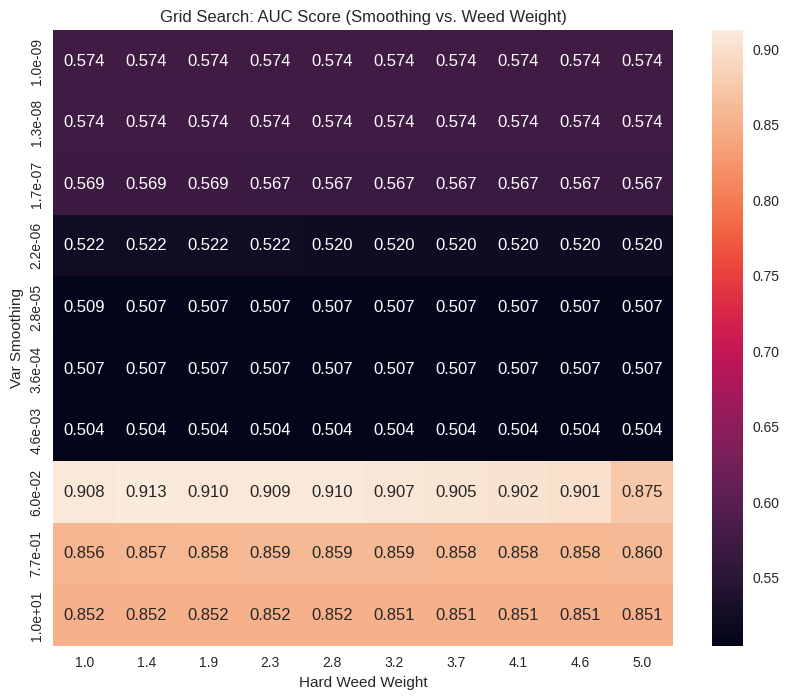

In [104]:
plt.figure(figsize=(10, 8))
sns.heatmap(auc_results, annot=True, fmt=".3f", 
            xticklabels=[f"{w:.1f}" for w in weight_grid], 
            yticklabels=[f"{s:.1e}" for s in smoothing_grid])
plt.title("Grid Search: AUC Score (Smoothing vs. Weed Weight)")
plt.xlabel("Hard Weed Weight")
plt.ylabel("Var Smoothing")
plt.show()

--- FINAL MODEL PERFORMANCE (Threshold: 0.9844) ---


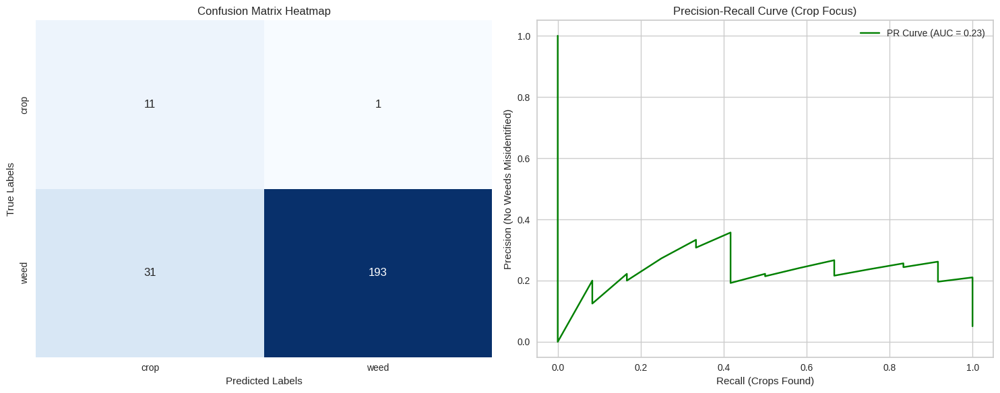

{'Accuracy sklearn': 0.864406779661017,
 'Accuracy custom': 0.864406779661017,
 'Conf Matrix': array([[ 11,   1],
       [ 31, 193]]),
 'Recall crop': 0.9166666666666666,
 'Recall weed': 0.8616071428571429,
 'Precision crop: (TP/(TP+FP))': 0.2619047619047619,
 'Precision weed': 0.9948453608247423,
 'F1 crop': 0.4074074074074074,
 'F1 weed': 0.9234449760765551,
 'F1 macro': 0.6654261917419813,
 'AUC score': 0.9125744047619048}


In [107]:
# 1. Prepare the final weights based on Grid Search results
final_weights = np.ones(len(y_train_gold))
final_weights[hard_weed_indices] = best_params['weight']

# 2. Initialize and Train the final "Surgical" Model
final_nb_clf = GaussianNB(var_smoothing=best_params['smooth'])
final_nb_clf.fit(X_train_gold, y_train_gold, sample_weight=final_weights)

# 3. Get the Probabilities for the PR-Curve
final_probs = final_nb_clf.predict_proba(X_test_gold)[:, 0] # Column 0 = 'crop'

# 4. Extract the Pinned Threshold from the curve (to save 11/12 crops)b
from sklearn.metrics import precision_recall_curve
precisions, recalls, thresholds = precision_recall_curve(y_test, final_probs, pos_label="crop")

# Find the threshold for ~92% Recall
target_recall = 0.91
idx = np.where(recalls >= target_recall)[0][-1]
pinned_t = thresholds[idx]

# 5. Create Final Binary Predictions
final_preds = ["crop" if p >= pinned_t else "weed" for p in final_probs]

# 6. Run the Final Evaluation
print(f"--- FINAL MODEL PERFORMANCE (Threshold: {pinned_t:.4f}) ---")
results = evaluate(y_test_gold, final_preds, y_probs=final_probs, print_cnfm=True)
pprint.pp(results)

In [87]:
#|export
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import precision_recall_curve

def run_gnb_optimization_and_evaluation(X_train, y_train, X_test, y_test, target_recall=0.91):
    """
    Performs grid search on smoothing and class weights, 
    visualizes the heatmap, and evaluates the final surgical model.
    """
    
    # 1. Identify 'hard weed' indices (Weeds often misclassified as crops)
    # This ensures the function is self-contained
    baseline_gnb = GaussianNB().fit(X_train, y_train)
    baseline_preds = baseline_gnb.predict(X_train)
    # Hard weeds are ground-truth 'weed' but predicted as 'crop'
    hard_weed_indices = np.where((y_train == "weed") & (baseline_preds == "crop"))[0]

    # 2. Define the grid
    smoothing_grid = np.logspace(-9, 1, 10)
    weight_grid = np.linspace(1.0, 5.0, 10)
    auc_results = np.zeros((len(smoothing_grid), len(weight_grid)))

    best_auc = 0
    best_params = {"smooth": 0, "weight": 0}

    print("Running Grid Search...")
    for i, s in enumerate(smoothing_grid):
        for j, w in enumerate(weight_grid):
            iter_weights = np.ones(len(y_train))
            iter_weights[hard_weed_indices] = w
            
            # Using your existing experiment function
            m, _, _ = experiment_gaussian_nb(X_train, y_train, X_test, y_test, 
                                           var_smoothing=s, 
                                           sample_weight=iter_weights)
            
            auc_results[i, j] = m["AUC score"]
            if m["AUC score"] > best_auc:
                best_auc = m["AUC score"]
                best_params = {"smooth": s, "weight": w}

    # 3. Plot Heatmap
    plt.figure(figsize=(10, 8))
    sns.heatmap(auc_results, annot=True, fmt=".3f", 
                xticklabels=[f"{w:.1f}" for w in weight_grid], 
                yticklabels=[f"{s:.1e}" for s in smoothing_grid],
                cmap="YlGnBu")
    plt.title("Grid Search: AUC Score (Smoothing vs. Weed Weight)")
    plt.xlabel("Hard Weed Weight")
    plt.ylabel("Var Smoothing")
    plt.show()

    print(f"Optimal found: Smoothing={best_params['smooth']:.2e}, Weight={best_params['weight']:.2f}")

    # 4. Final "Surgical" Model Training
    final_weights = np.ones(len(y_train))
    final_weights[hard_weed_indices] = best_params['weight']
    
    final_nb_clf = GaussianNB(var_smoothing=best_params['smooth'])
    final_nb_clf.fit(X_train, y_train, sample_weight=final_weights)
    
    # Probabilities for 'crop' (Column 0)
    final_probs = final_nb_clf.predict_proba(X_test)[:, 0]

    # 5. Threshold Pinning for High Recall
    precisions, recalls, thresholds = precision_recall_curve(y_test, final_probs, pos_label="crop")
    
    # Find the threshold for target_recall
    idx = np.where(recalls >= target_recall)[0][-1]
    pinned_t = thresholds[idx]

    # 6. Final Evaluation
    final_preds = ["crop" if p >= pinned_t else "weed" for p in final_probs]
    print(f"\n--- FINAL MODEL PERFORMANCE (Pinned Threshold: {pinned_t:.4f}) ---")
    results = evaluate(y_test, final_preds, y_probs=final_probs, print_cnfm=True)
    
    return final_nb_clf, pinned_t